In [1]:
import numpy as np
import os 
import h5py
import matplotlib.pyplot as plt
import torch
from torch.utils.data import Dataset, DataLoader
from torch import nn

In [2]:
# Directory containing .h5 files
directory = '/kaggle/input/brats2020-training-data/BraTS2020_training_data/content/data'

# Create a list of all .h5 files in the directory
h5_files = [f for f in os.listdir(directory) if f.endswith('.h5')]
print(f'Found {len(h5_files)} .h5 files:\nExample file names:{h5_files[:3]}')

# Open the first .h5 file in the list to inspect its contents
if h5_files:
    filepath = os.path.join(directory, h5_files[25070])
    with h5py.File(filepath, 'r') as file:
        print(f'\nKeys for each file:', list(file.keys()))
        for key in file.keys():
            print(f"\nData type of {key}:", type(file[key][()]))
            print(f"Shape of {key}:", file[key].shape)
            print(f"Array dtype: {file[key].dtype}")
            print(f"Array max val: {np.max(file[key])}")
            print(f"Array min val: {np.min(file[key])}")
else:
    print("No .h5 files found in the directory.")

Found 57195 .h5 files:
Example file names:['volume_337_slice_56.h5', 'volume_293_slice_67.h5', 'volume_149_slice_44.h5']

Keys for each file: ['image', 'mask']

Data type of image: <class 'numpy.ndarray'>
Shape of image: (240, 240, 4)
Array dtype: float64
Array max val: 20.749972557838987
Array min val: -0.15242355609407895

Data type of mask: <class 'numpy.ndarray'>
Shape of mask: (240, 240, 3)
Array dtype: uint8
Array max val: 0
Array min val: 0


## About the Dataset
This dataset is from Brats2020. It consists of images from brain scans, as well as masked labels indicating regions of abnormal tissue. Each image has 4 channels.

*Each pixel on image must be labeled:*
* Pixel is part of a tumor area (1 or 2 or 3) -> can be one of multiple classes / sub-regions
* Anything else -> pixel is not on a tumor region (0)

The sub-regions of tumor considered for evaluation are: 1) the "enhancing tumor" (ET), 2) the "tumor core" (TC), and 3) the "whole tumor" (WT)
The provided segmentation labels have values of 1 for NCR & NET, 2 for ED, 4 for ET, and 0 for everything else.

![Brats official annotations](https://www.med.upenn.edu/cbica/assets/user-content/images/BraTS/brats-tumor-subregions.jpg)

#### Image channels:
1) **T1-weighted (T1)**: This sequence produces a high resolution image of the brain's anatomy. It's good for visualising the structure of the brain but not as sensitive to tumour tissue as other sequences.

2) **T1-weighted post contrast (T1c or T1Gd)**: After the injection of a contrast agent (usually gadolinium), T1-weighted images are taken again. The contrast agent enhances areas with a high degree of vascularity and blood-brain barrier breakdown, which is typical in tumour tissue, making this sequence particularly useful for highlighting malignant tumours.

3) **T2-weighted (T2)**: T2 images provide excellent contrast of the brain's fluid spaces and are sensitive to edema (swelling), which often surrounds tumours. It helps in visualizing both the tumour and changes in nearby tissue.

4) **Fluid Attenuated Inversion Recovery (FLAIR)**: This sequence suppresses the fluid signal, making it easier to see peritumoral edema (swelling around the tumour) and differentiate it from the cerebrospinal fluid. It's particularly useful for identifying lesions near or within the ventricles.

Regarding the masks, they represent segmentations, containing areas of interest within the brain scans, specifically focusing on abnormal tissue related to brain tumours. We will use these masks for training models in segmenting brain tumours from normal brain tissue. Each mask has 3 channels.

#### Mask channels
1) **Necrotic and Non-Enhancing Tumour Core (NCR/NET)**: This masks out the necrotic (dead) part of the tumour, which doesn't enhance with contrast agent, and the non-enhancing tumour core.

2) **Edema (ED)**: This channel masks out the edema, the swelling or accumulation of fluid around the tumour.

3) **Enhancing Tumour (ET)**: This masks out the enhancing tumour, which is the region of the tumour that shows uptake of contrast material and is often considered the most aggressive part of the tumour.

## Utility functions to plot the image & mask channels

In [3]:
import matplotlib.pyplot as plt
plt.style.use('ggplot')
plt.rcParams['figure.facecolor'] = '#171717'
plt.rcParams['text.color'] = '#DDDDDD'

def display_image_channels(image, title='Image Channels'):
    channel_names = ['T1-weighted (T1)', 'T1-weighted post contrast (T1c)', 'T2-weighted (T2)', 'Fluid Attenuated Inversion Recovery (FLAIR)']
    fig, axes = plt.subplots(2, 2, figsize=(15, 15))
    for idx, ax in enumerate(axes.flatten()):
        channel_image = image[idx, :, :] # Transpose the array to display the channel
        ax.imshow(channel_image, cmap='magma')
        ax.axis('off')
        ax.set_title(channel_names[idx])
    plt.tight_layout()
    plt.suptitle(title, fontsize=20, y=1.03)
    plt.show

def display_mask_channels_as_rgb(mask, title='Mask Channels as RGB'):
    channel_names = ['Necrotic (NEC)', 'Edema (ED)', 'Tumour (ET)']
    fig, axes = plt.subplots(1, 3, figsize=(9.75, 5))
    for idx, ax in enumerate(axes):
        rgb_mask = np.ones((mask.shape[1], mask.shape[2], 3), dtype=np.uint8)
        rgb_mask[..., idx] = mask[idx, :, :] * 255  # Transpose the array to display the channel
        ax.imshow(rgb_mask)
        ax.axis('off')
        ax.set_title(channel_names[idx])
    plt.suptitle(title, fontsize=20, y=0.93)
    plt.tight_layout()
    plt.show()

def overlay_masks_on_image(image, mask, title='Brain MRI with Tumour Masks Overlay'):
    t1_image = image[0, :, :] # Use the first channel of the image
    t1_image_normalized = (t1_image - t1_image.min()) / (t1_image.max() - t1_image.min())
    
    rgb_image = np.stack([t1_image_normalized] * 3, axis=-1)
    color_mask = np.stack([mask[0, :, :], mask[1, :, :], mask[2, :, :]], axis=-1)
    rgb_image = np.where(color_mask, color_mask, rgb_image)
    
    plt.figure(figsize=(8, 8))
    plt.imshow(rgb_image)
    plt.title(title, fontsize=20, y=0.93)
    plt.axis('off')
    plt.show()

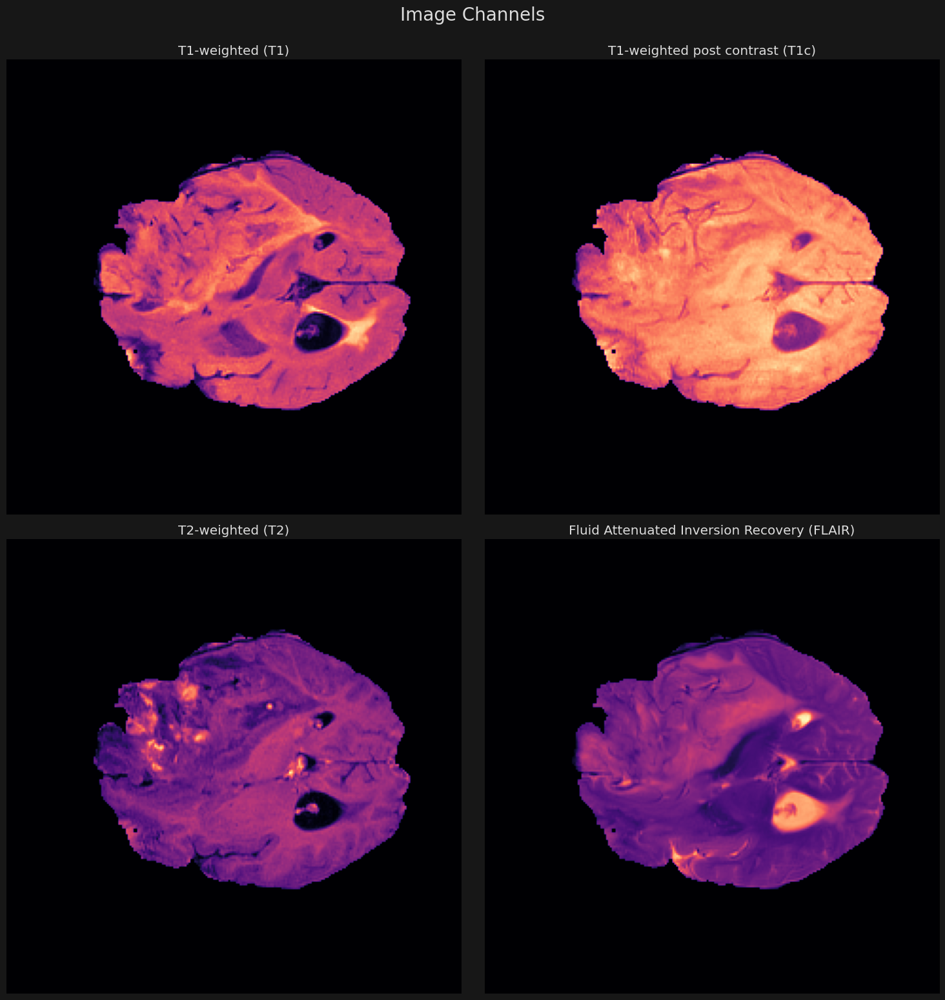

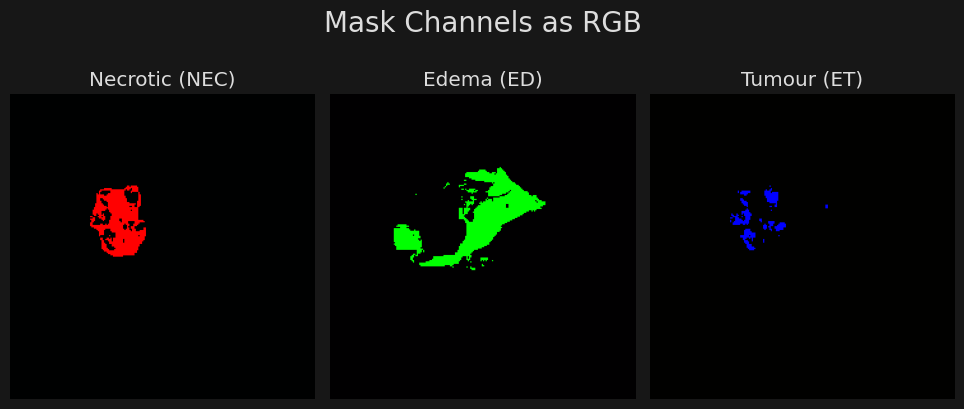

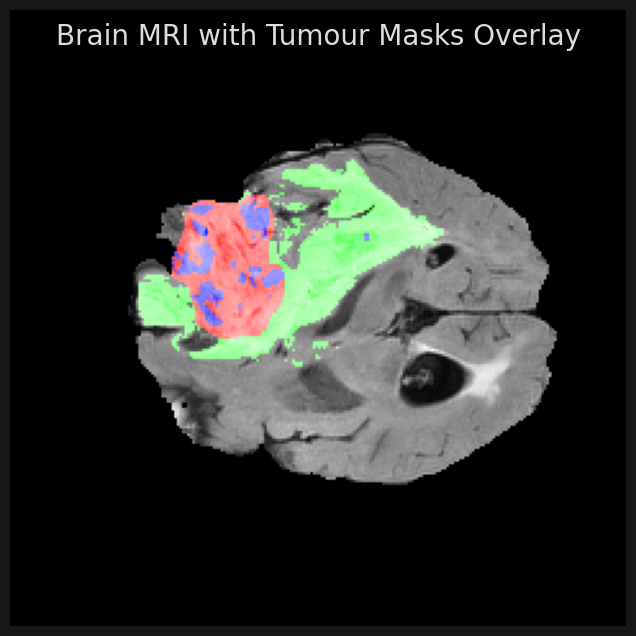

In [4]:
# Sample image to view 
sample_file_path = os.path.join(directory, h5_files[1])
data = {}
with h5py.File(sample_file_path, 'r') as file:
    for key in file.keys():
        data[key] = file[key][()]
        
# Transpose the image and mask to have channels first
image = data['image'].transpose(2, 0, 1)
mask = data['mask'].transpose(2, 0, 1)

# View image using plotting functionsz
display_image_channels(image)
display_mask_channels_as_rgb(mask)
overlay_masks_on_image(image, mask)

### Creating a Dataset and DataLoader

This dataset is quite large (around 8GB), so during training we will use dataloaders to load batches of image + target pairs. Since these images are formatted unconventionally, we'll need to build a custom Dataset object and DataLoader.

Images are stored using the float64 data type with pixel intensities ranging from ~-0.5 to ~230 and height, width, channels format. The masks use the uint8 data type and pixels have values of either 0 or 1.

Our dataloader will need to load an image, reshape it so it's formatted channels, height, width for use in PyTorch, adjust pixel intensities so the minimum value is 0 on every image, then scale each channel so the max is 1, then convert to a torch.float32 tensor.

In [5]:
class BrainScanDataset(Dataset):
    def __init__(self, filepaths, deterministic=False):
        self.filepaths = filepaths
        if deterministic: # To always generate the same test images for consistency
            np.random.seed(1)
        np.random.shuffle(self.filepaths)
        
    def __len__(self):
        return len(self.filepaths)
    
    def __getitem__(self, idx):
        # Load h5 file, get image and mask
        filepath = self.filepaths[idx]
        with h5py.File(filepath, 'r') as file:
            image = file['image'][()]
            mask = file['mask'][()]
            
            # Reshape: (H, W, C) -> (C, H, W)
            image = image.transpose((2, 0, 1))
            mask = mask.transpose((2, 0, 1))
            
            # Adjusting pixel values for each channel in the image so they are between 0 and 255
            for i in range(image.shape[0]):
                image[i] = (image[i]-np.min(image[i])) / (np.max(image[i]) - np.min(image[i]) + 1e-4) # applying MinMax normalization
                                    
            # Convert to float and scale the whole image 
            image = torch.tensor(image, dtype=torch.float32)
            mask = torch.tensor(mask, dtype=torch.float32)     
            
        return image, mask          

In [6]:
# Build .h5 file paths from directory containing .h5 files
h5_files = [os.path.join(directory, f) for f in os.listdir(directory) if f.endswith('.h5')]
np.random.seed(42)
np.random.shuffle(h5_files)

# Split the dataset into train and validation sets (90:10)
split_idx = int(0.9 * len(h5_files))
train_files = h5_files[:split_idx]
val_files = h5_files[split_idx:]

# Create the train and val datasets
train_dataset = BrainScanDataset(train_files)
val_dataset = BrainScanDataset(val_files, deterministic=True)

In [7]:
train_dataset.__getitem__(5)

(tensor([[[0., 0., 0.,  ..., 0., 0., 0.],
          [0., 0., 0.,  ..., 0., 0., 0.],
          [0., 0., 0.,  ..., 0., 0., 0.],
          ...,
          [0., 0., 0.,  ..., 0., 0., 0.],
          [0., 0., 0.,  ..., 0., 0., 0.],
          [0., 0., 0.,  ..., 0., 0., 0.]],
 
         [[0., 0., 0.,  ..., 0., 0., 0.],
          [0., 0., 0.,  ..., 0., 0., 0.],
          [0., 0., 0.,  ..., 0., 0., 0.],
          ...,
          [0., 0., 0.,  ..., 0., 0., 0.],
          [0., 0., 0.,  ..., 0., 0., 0.],
          [0., 0., 0.,  ..., 0., 0., 0.]],
 
         [[0., 0., 0.,  ..., 0., 0., 0.],
          [0., 0., 0.,  ..., 0., 0., 0.],
          [0., 0., 0.,  ..., 0., 0., 0.],
          ...,
          [0., 0., 0.,  ..., 0., 0., 0.],
          [0., 0., 0.,  ..., 0., 0., 0.],
          [0., 0., 0.,  ..., 0., 0., 0.]],
 
         [[0., 0., 0.,  ..., 0., 0., 0.],
          [0., 0., 0.,  ..., 0., 0., 0.],
          [0., 0., 0.,  ..., 0., 0., 0.],
          ...,
          [0., 0., 0.,  ..., 0., 0., 0.],
       

In [8]:
# Sample dataloaders
train_dataloader = DataLoader(train_dataset, batch_size=5, shuffle=True)
val_dataloader = DataLoader(val_dataset, batch_size=5, shuffle=False)

# Use this to generate test images to view later
test_input_iterator = iter(DataLoader(val_dataset, batch_size=1, shuffle=False))

# Verifying dataloaders work
for images, masks in train_dataloader:
    print(f'Training batch - Images shape: {images.shape}, Masks shape: {masks.shape}')
    break
for images, masks in val_dataloader:
    print(f"Validation batch - Images shape: {images.shape}, Masks shape: {masks.shape}")
    break

Training batch - Images shape: torch.Size([5, 4, 240, 240]), Masks shape: torch.Size([5, 3, 240, 240])
Validation batch - Images shape: torch.Size([5, 4, 240, 240]), Masks shape: torch.Size([5, 3, 240, 240])


## The UNet Architecture

<img src="https://lmb.informatik.uni-freiburg.de/people/ronneber/u-net/u-net-architecture.png" 
     align="right" 
     width="1000"
     style="padding: 20px;" />
     
[UNet](https://arxiv.org/abs/1505.04597) is a deep learning neural network architecture originally designed for image segmentation tasks, but has since found use in GANs and latent diffusion models. Similar to autoencoders, the UNet structures include an encoder for compressing the input into a lower dimensional representation and a decoder for reconstructing the output from this compressed form. However, UNet distinguishes itself from autoencoders with several features:

- **Bottleneck**: At the centre of UNet is the bottleneck layer, situated between the encoder and decoder. This component captures the most abstract representation of the input.

- **Symmetrical Design**: The encoder and decoder parts of UNet are mirror images of each other. This symmetry facilitates the implementation of skip connections, which directly connect layers of the encoder to their corresponding layers in the decoder.

- **Skip Connections**: Unlike conventional autoencoders, UNet incorporates skip connections that can bypass the bottleneck, directly connecting the encoder to the decoder. These connections transfer contextual information from the spatially rich encoder, to the more feature heavy decoder, aiding in the precise localisation necessary for detailed segmentation.

In this project we're going to start off with the original UNet architecture, then work on building in some staple CV tweaks like separable convolution layers, batch norm, fewer activation functions, additive skip connections, larger kernels, then finally include the attention mechanism from [Attention UNet](https://arxiv.org/abs/1804.03999).

In [9]:
class EncoderBlock(nn.Module):
    
    def __init__(self, in_channels, out_channels, activation=nn.ReLU()):
        super().__init__()
        self.encoder_block = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=(3, 3), stride=1, padding=1),
            activation,
            nn.Conv2d(out_channels, out_channels, kernel_size=(3, 3), stride=1, padding=1),
            activation
        )
        
    def forward(self, x):
        return self.encoder_block(x)

class DecoderBlock(nn.Module):
    
    def __init__(self, in_channels, out_channels, activation=nn.ReLU()):
        super().__init__()
        self.decoder_block = nn.Sequential(
            nn.Conv2d(in_channels, in_channels//2, kernel_size=(3, 3), stride=1, padding=1),
            activation,
            nn.Conv2d(in_channels//2, out_channels, kernel_size=(3, 3), stride=1, padding=1),
            activation
        )
    
    def forward(self, x):
        return self.decoder_block(x)
    
class UNet(nn.Module):
    def __init__(self):
        super().__init__()

        # Config
        in_channels  = 4   # Input images have 4 channels
        out_channels = 3   # Mask has 3 channels
        n_filters    = 32  # Scaled down from 64 in original paper
        activation   = nn.ReLU()

        # Up and downsampling methods
        self.downsample  = nn.MaxPool2d((2,2), stride=2)
        self.upsample    = nn.UpsamplingBilinear2d(scale_factor=2)

        # Encoder
        self.enc_block_1 = EncoderBlock(in_channels, 1*n_filters, activation)
        self.enc_block_2 = EncoderBlock(1*n_filters, 2*n_filters, activation)
        self.enc_block_3 = EncoderBlock(2*n_filters, 4*n_filters, activation)
        self.enc_block_4 = EncoderBlock(4*n_filters, 8*n_filters, activation)

        # Bottleneck

        self.bottleneck = nn.Sequential(
            nn.Conv2d(8*n_filters, 16*n_filters, kernel_size=(3, 3), stride=1, padding=1),
            activation,
            nn.Conv2d(16*n_filters, 8*n_filters, kernel_size=(3, 3), stride=1, padding=1),
            activation
        )

        # Decoder
        self.dec_block_4 = DecoderBlock(16*n_filters, 4*n_filters, activation)
        self.dec_block_3 = DecoderBlock(8*n_filters, 2*n_filters, activation)
        self.dec_block_2 = DecoderBlock(4*n_filters, 1*n_filters, activation)
        self.dec_block_1 = DecoderBlock(2*n_filters, 1*n_filters, activation)

        # Output projection
        self.output = nn.Conv2d(1*n_filters, out_channels, kernel_size=(1, 1), stride=1, padding=0)

    def forward(self, x):

        # Encoder
        skip_1 = self.enc_block_1(x)
        x      = self.downsample(skip_1)
        skip_2 = self.enc_block_2(x)
        x      = self.downsample(skip_2)
        skip_3 = self.enc_block_3(x)
        x      = self.downsample(skip_3)
        skip_4 = self.enc_block_4(x)
        x      = self.downsample(skip_4)

        # Bottleneck
        x      = self.bottleneck(x)

        # Decoder
        x      = self.upsample(x)
        x      = torch.cat((x, skip_4), axis=1) # adding the skip connection
        x      = self.dec_block_4(x)
        x      = self.upsample(x)
        x      = torch.cat((x, skip_3), axis=1)  # Skip connection
        x      = self.dec_block_3(x)
        x      = self.upsample(x)
        x      = torch.cat((x, skip_2), axis=1)  # Skip connection
        x      = self.dec_block_2(x)
        x      = self.upsample(x)
        x      = torch.cat((x, skip_1), axis=1)  # Skip connection
        x      = self.dec_block_1(x)
        x      = self.output(x)
        return x
        
    
# Function to count number of parameters in a model for comparisons later
def count_parameters(model):
    total_params = sum(p.numel() for p in model.parameters())
    print(f'Total Parameters: {total_params:,}\n')

# Function that saves a model to specified path
def save_model(model, path='model_weights.pth'):
    torch.save(model.state_dict(), path)

In [10]:
def train_model(model, train_dataloader, val_dataloader, config, verbose=True):
    device = config['device']
    n_epochs = config['n_epochs']
    learning_rate = config['learning_rate']
    batches_per_epoch = config['batches_per_epoch']
    lr_decay_factor = config['lr_decay_factor']
    
    model.to(device)
    optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)
    loss_fn = nn.BCEWithLogitsLoss()
    
    train_epoch_losses = []
    val_epoch_losses = []
    
    print('Training...')
    for epoch in range(1, n_epochs+1):
        # Decay learning rate
        current_lr = learning_rate * (lr_decay_factor ** (epoch - 1))
        for param_group in optimizer.param_groups:
            param_group['lr'] = current_lr
        
        # Training step
        model.train()
        train_epoch_loss = 0
        for train_batch_idx, (train_inputs, train_targets) in enumerate(train_dataloader, start=1):
            if verbose: 
                print(f'\rTrain batch: {train_batch_idx}/{batches_per_epoch}, Avg batch loss: {train_epoch_loss/train_batch_idx:.6f}', end='')
            train_inputs = train_inputs.to(device)
            train_targets = train_targets.to(device)
            train_preds = model(train_inputs)
            train_batch_loss = loss_fn(train_preds, train_targets)
            train_batch_loss = train_batch_loss.to('cpu')
            train_epoch_loss += train_batch_loss.item()


            optimizer.zero_grad()
            train_batch_loss.backward()
            optimizer.step()
                
                
            if train_batch_idx >= batches_per_epoch:
                if verbose: print()
                break
        train_epoch_losses.append(train_epoch_loss)
        
        # Val step
        model.eval()
        val_epoch_loss = 0
        with torch.no_grad():
            for val_batch_idx, (val_inputs, val_targets) in enumerate(val_dataloader, start=1):
                if verbose: 
                    print(f'\rVal batch: {val_batch_idx}/{batches_per_epoch}, Avg batch loss: {val_epoch_loss/val_batch_idx:.6f}', end='')
                val_inputs = val_inputs.to(device)
                val_targets = val_targets.to(device)
                val_preds = model(val_inputs)
                val_batch_loss = loss_fn(val_preds, val_targets)
                val_batch_loss = val_batch_loss.to('cpu')
                val_epoch_loss += val_batch_loss.item()

                if val_batch_idx >= batches_per_epoch:
                    if verbose: print()
                    break
        val_epoch_losses.append(val_epoch_loss)
        
        if verbose: print(f"Epoch: {epoch}, Train loss: {train_epoch_loss:.6f}, Val loss: {val_epoch_loss:.6f}, lr {current_lr:.6f}\n")
        
    print("Training complete.")
    return train_epoch_losses, val_epoch_losses

## Interpretability of the model

In [11]:
# def visualize_activations(model, test_input, device):
#     activations = []
#     hooks = []

#     def hook_fn(module, input, output):
#         activations.append(output.cpu().detach().numpy())

#     # Register hook for each layer
#     for name, module in model.named_modules():
#         hook = module.register_forward_hook(hook_fn)
#         hooks.append(hook)

#     # Pass test input through the model
#     test_input = test_input.to(device)
#     model.eval()
#     with torch.no_grad():
#         model(test_input)

#     # Remove hooks
#     for hook in hooks:
#         hook.remove()

#     # Ensure activations have the same number of channels
#     min_channels_per_layer = min(activation.shape[1] for activation in activations)
#     activations = [activation[:, :min_channels_per_layer] for activation in activations]

#     # Visualize activations separately for each layer
#     for i, activation in enumerate(activations):
#         tsne = TSNE(n_components=2, perplexity=1)
#         pca = PCA(n_components=2)
#         tsne_activations = tsne.fit_transform(activation.reshape(activation.shape[0], -1))
#         pca_activations = pca.fit_transform(activation.reshape(activation.shape[0], -1))

#         # Plot activations
#         fig, axes = plt.subplots(1, 2, figsize=(12, 6))

#         axes[0].scatter(tsne_activations[:, 0], tsne_activations[:, 1])
#         axes[0].set_title(f'Activations Layer {i+1} (t-SNE)')
#         axes[0].set_xlabel('Component 1')
#         axes[0].set_ylabel('Component 2')

#         axes[1].scatter(pca_activations[:, 0], pca_activations[:, 1])
#         axes[1].set_title(f'Activations Layer {i+1} (PCA)')
#         axes[1].set_xlabel('Component 1')
#         axes[1].set_ylabel('Component 2')

#         plt.tight_layout()
#         plt.show()

## Training Loop
The code in the cell below defines and executes the training loop for our UNet models. 

The training process involves:
- Setting up the model and training configuration.
- Initialising the model and moving it to the chosen device.
- Adam optimizer for parameter updates and binary cross-entropy loss as the loss function.
- We then iterate through each epoch, we can optionally dynamically adjust the learning rate.

For each epoch, we conduct both training and validation steps:
- In the training step, we feed batches of data to the model, computes the loss, and updates the model parameters.
- In the validation step, we evaluate the model on a separate dataset to monitor performance without updating model parameters.
- We track and print out the average training and validation losses for each epoch, providing insights into the model's learning progress.

Finally, the function returns lists of training and validation losses for further analysis or plotting.

In [12]:
# Settings for training
train_config = {
    'device': 'cuda' if torch.cuda.is_available() else 'cpu',
    'n_epochs':          12,
    'batch_size':        32,
    'learning_rate':     1e-3,
    'batches_per_epoch': 50,
    'lr_decay_factor':   1
}

# Create UNet model and count params
model = UNet()
count_parameters(model)

# Create dataloaders
train_dataloader = DataLoader(train_dataset, batch_size=train_config['batch_size'], shuffle=True)

val_dataloader = DataLoader(val_dataset, batch_size=train_config['batch_size'], shuffle=False)

# Train model
train_epoch_losses, val_epoch_losses = train_model(model, train_dataloader, val_dataloader, train_config, verbose=True)

Total Parameters: 5,496,451

Training...
Train batch: 50/50, Avg batch loss: 0.120697
Val batch: 50/50, Avg batch loss: 0.017937
Epoch: 1, Train loss: 6.053917, Val loss: 0.919990, lr 0.001000

Train batch: 50/50, Avg batch loss: 0.018102
Val batch: 50/50, Avg batch loss: 0.015715
Epoch: 2, Train loss: 0.915296, Val loss: 0.806765, lr 0.001000

Train batch: 50/50, Avg batch loss: 0.014858
Val batch: 50/50, Avg batch loss: 0.013137
Epoch: 3, Train loss: 0.759598, Val loss: 0.675236, lr 0.001000

Train batch: 50/50, Avg batch loss: 0.012668
Val batch: 50/50, Avg batch loss: 0.011733
Epoch: 4, Train loss: 0.647297, Val loss: 0.601625, lr 0.001000

Train batch: 50/50, Avg batch loss: 0.010504
Val batch: 50/50, Avg batch loss: 0.009778
Epoch: 5, Train loss: 0.536129, Val loss: 0.501238, lr 0.001000

Train batch: 50/50, Avg batch loss: 0.010582
Val batch: 50/50, Avg batch loss: 0.009526
Epoch: 6, Train loss: 0.536809, Val loss: 0.488497, lr 0.001000

Train batch: 50/50, Avg batch loss: 0.010

# Learning Visualization

In [13]:
def plot_learning_curves(train_epoch_losses, val_epoch_losses):
    plt.style.use('ggplot')
    plt.rcParams['text.color'] = '#333333'

    fig, axis = plt.subplots(1, 1, figsize=(10, 6))

    # Plot training and validation loss (NaN is used to offset epochs by 1)
    axis.plot([np.NaN] + train_epoch_losses, color='#636EFA', marker='o', linestyle='-', linewidth=2, markersize=5, label='Training Loss')
    axis.plot([np.NaN] + val_epoch_losses,   color='#EFA363', marker='s', linestyle='-', linewidth=2, markersize=5, label='Validation Loss')

    # Adding title, labels and formatting
    axis.set_title('Training and Validation Loss Over Epochs', fontsize=16)
    axis.set_xlabel('Epoch', fontsize=14)
    axis.set_ylabel('Loss', fontsize=14)

    axis.set_ylim(0, 1)
    
    axis.legend(fontsize=12)
    axis.grid(True, which='both', linestyle='--', linewidth=0.5)
    plt.show()

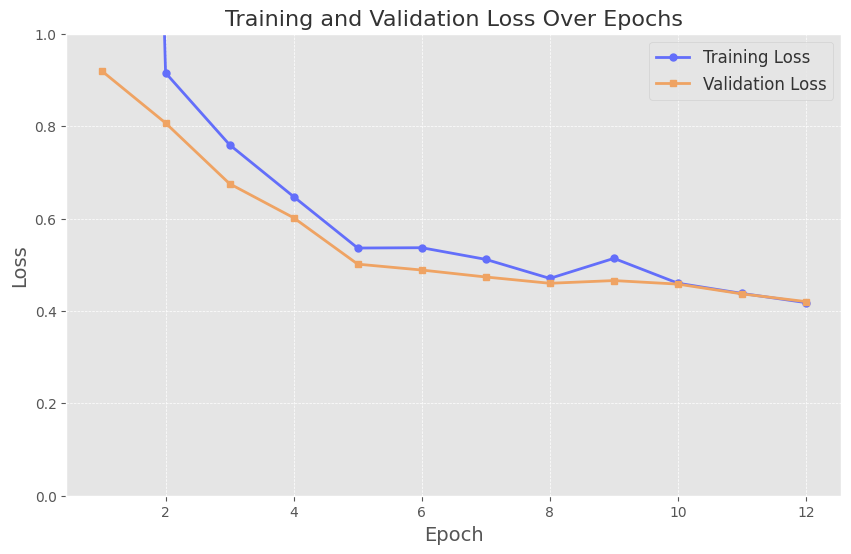

In [14]:
# train_epoch_losses = [train_epoch_loss.cpu() for train_epoch_loss in train_epoch_losses]
# train_epoch_losses = train_epoch_losses.numpy()
# val_epoch_losses = [val_epoch_loss.cpu() for val_epoch_loss in val_epoch_losses]
# val_epoch_losses = val_epoch_losses.numpy()
plot_learning_curves(train_epoch_losses, val_epoch_losses)

## Visualize a sample prediction

In [15]:
def display_test_sample(model, test_input, test_target, device):
    test_input, test_target = test_input.to(device), test_target.to(device)
    
    # Obtain the model's prediction 
    test_pred = torch.sigmoid(model(test_input))
    
    # Process the image and masks for visualization
    image = test_input.detach().cpu().numpy().squeeze(0)
    mask_pred = test_pred.detach().cpu().numpy().squeeze(0)
    mask_target = test_target.detach().cpu().numpy().squeeze(0)
    
    # Set the plot aesthetics 
    plt.rcParams['figure.facecolor'] = '#171717'
    plt.rcParams['text.color']       = '#DDDDDD'
    
    # Display the input image, predicted mask and target mask 
    display_image_channels(image)
    display_mask_channels_as_rgb(mask_pred, title='Predicted Mask Channels as RGB')
    display_mask_channels_as_rgb(mask_target, title='Ground Truth as RGB')

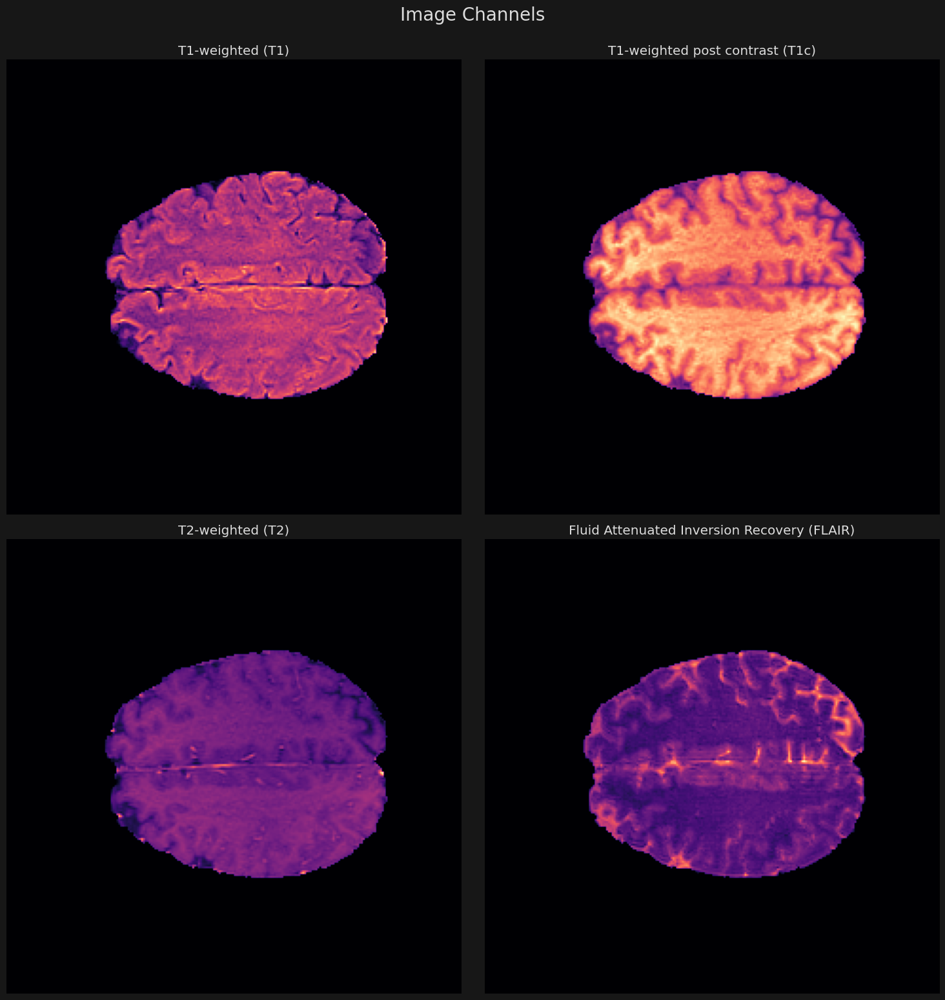

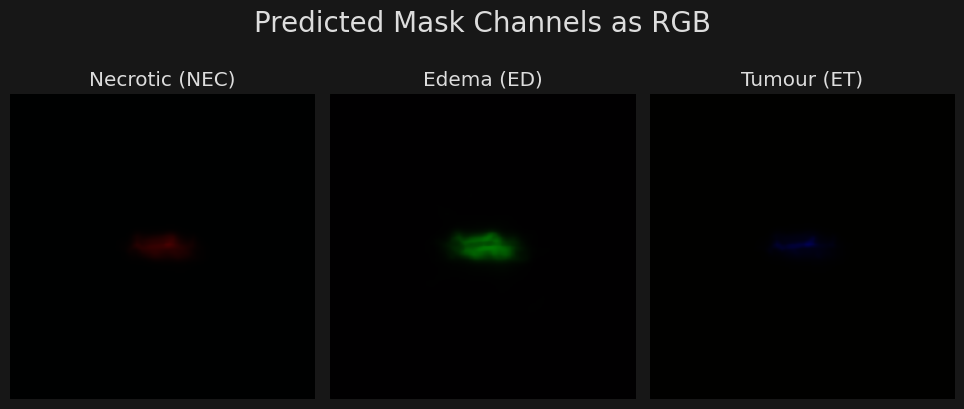

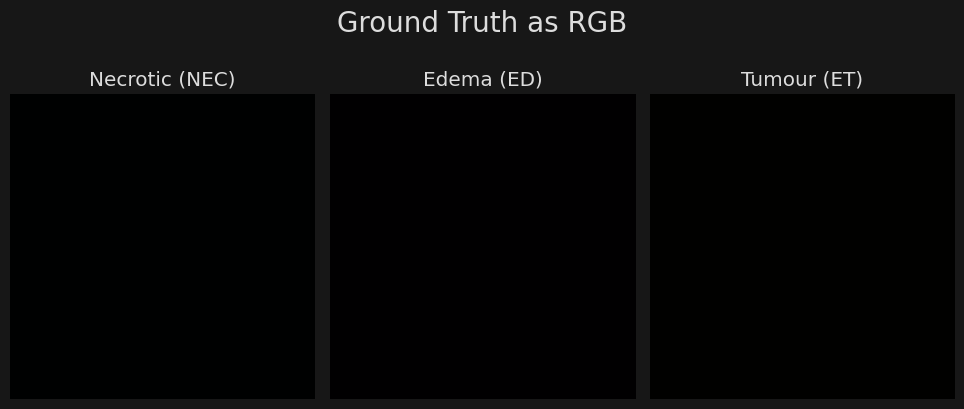

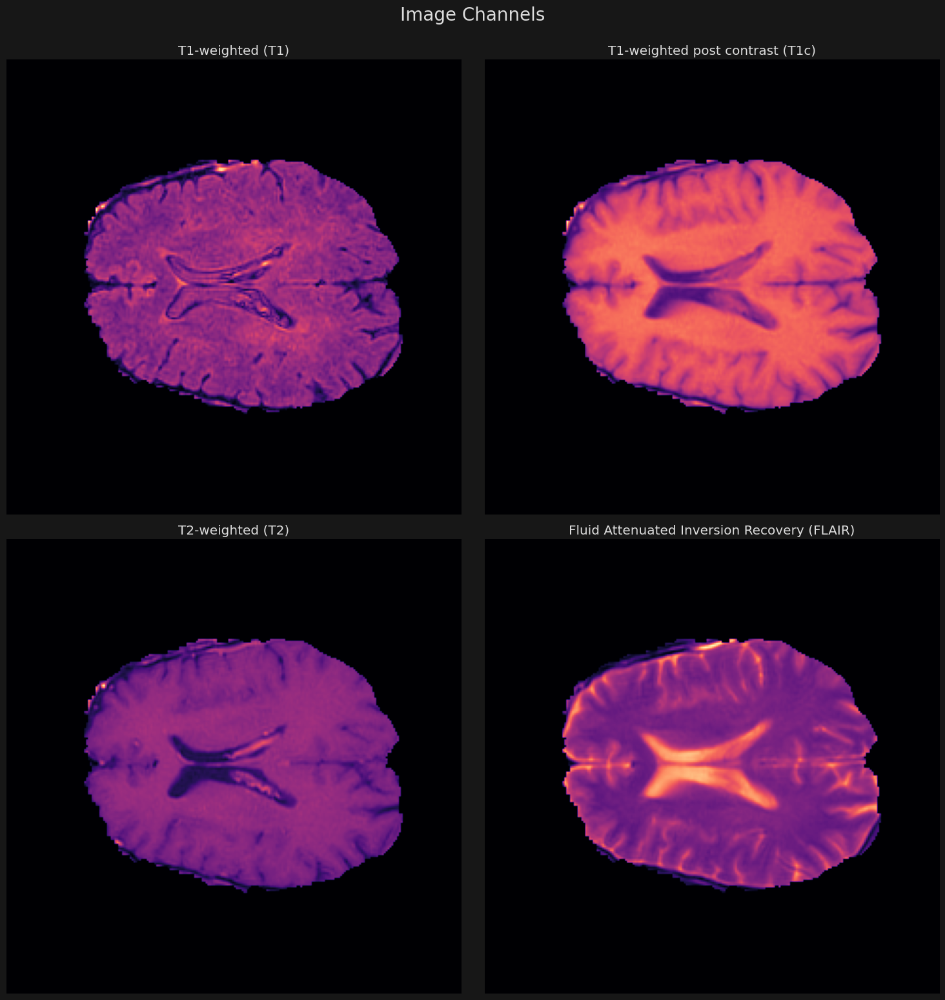

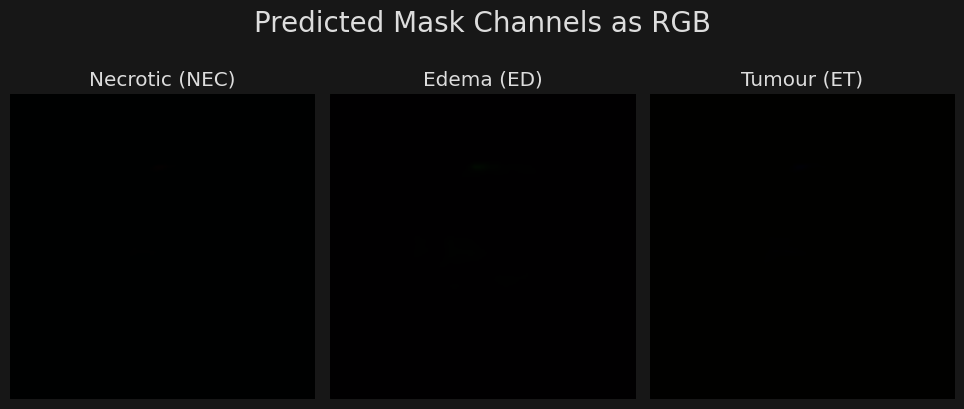

...

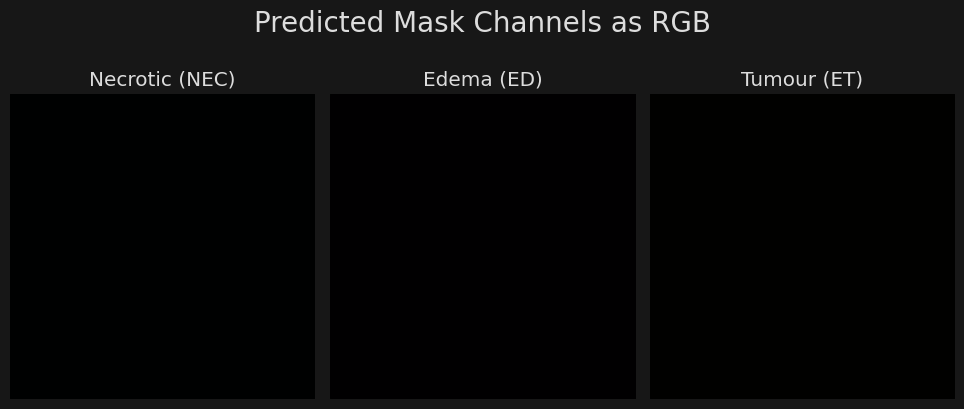

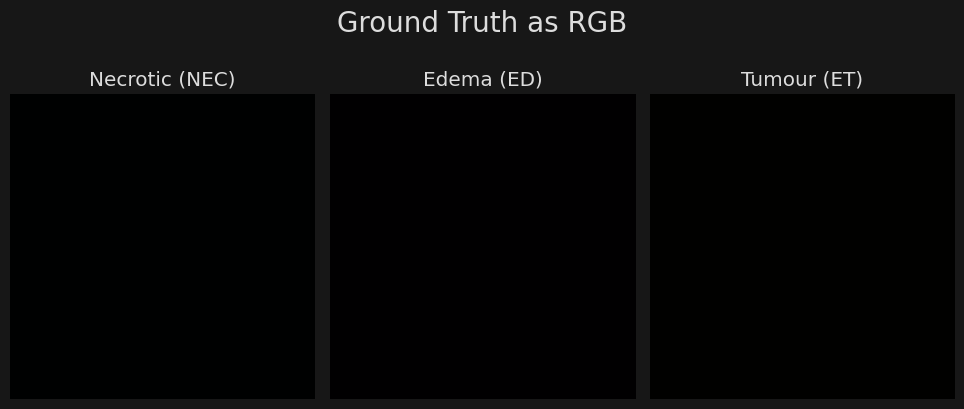

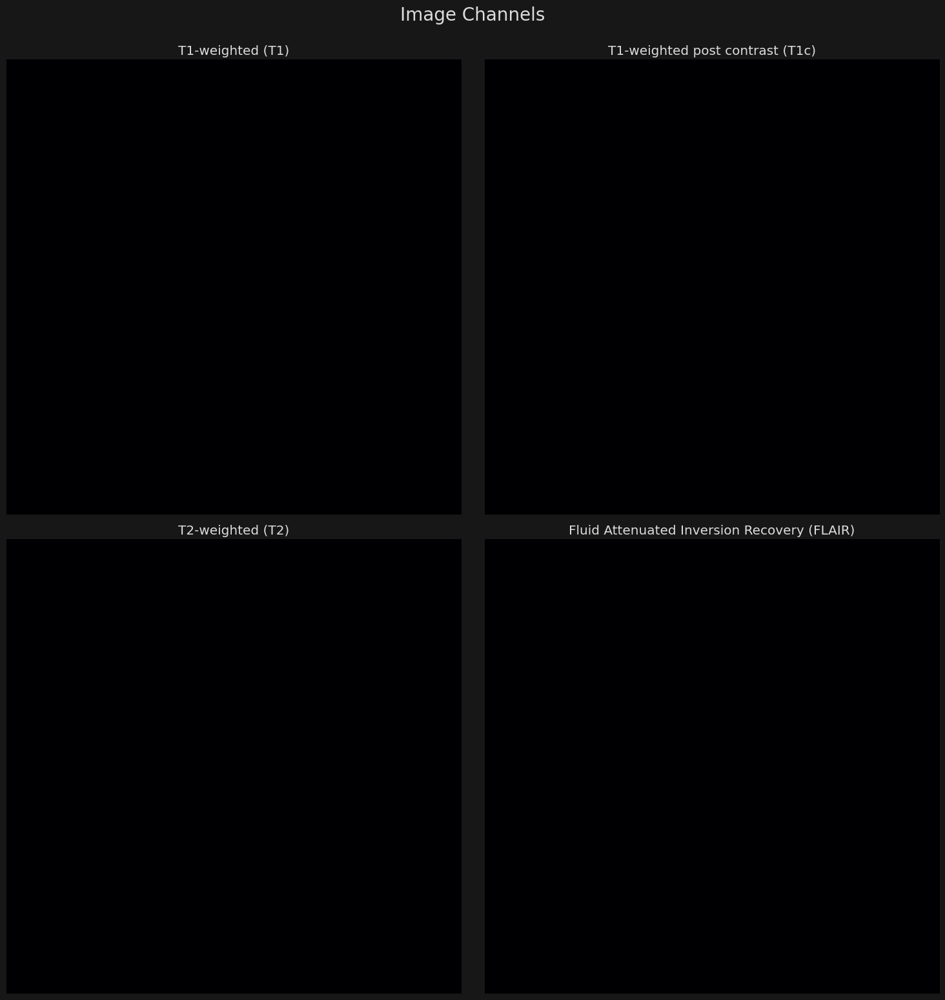

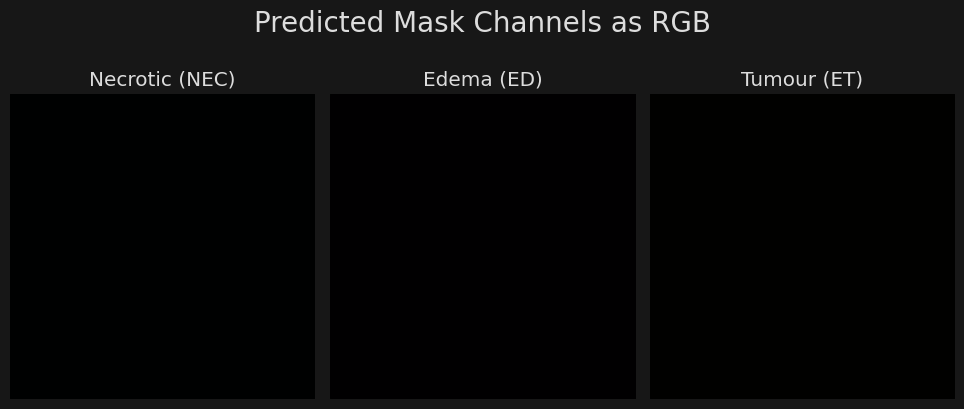

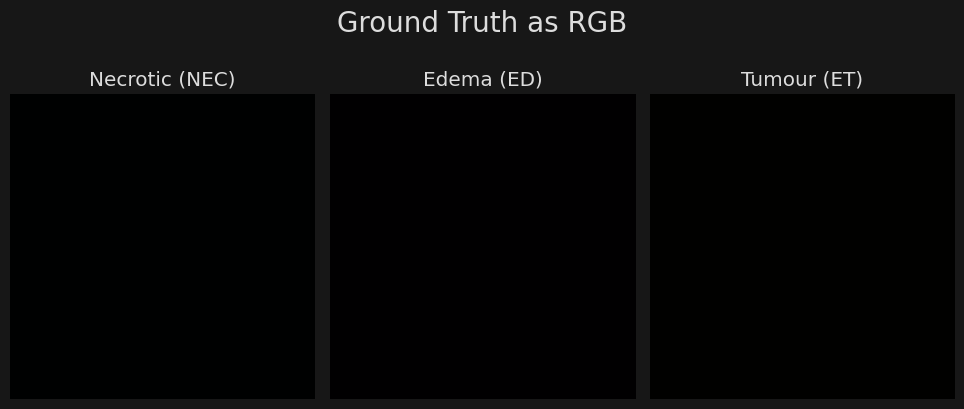

In [16]:
# Set so model and these images are on the same device
device = 'cuda' if torch.cuda.is_available() else 'cpu'

# Get an image from the validation dataset that the model hasn't been trained on

for i in range(40):
    test_input, test_target = next(test_input_iterator)

    display_test_sample(model, test_input, test_target, device)  

### Visualize Activations

In [17]:
# # Visualize activations
# for i in range(40):
#     test_input, test_target = next(test_input_iterator)
#     visualize_activations(model, test_input, device)

### Thoughts

- The model is for 12 epochs, where each epoch consisted of 50 batches of 32 images, for approximately 20,000 images out of the total training set of 55,000.
- The Vanilla Unet is able to generalize the region of tumours but it is not segmenting the different regions accurately.

## Upgraded UNet 

This vanilla Unet is a smaller version of the original [U-Net](https://arxiv.org/abs/1505.04597) paper. But rather than increasing the parameters let's apply some advanced CV tweaks to improve the performance.

#### Separable convolution layers
Popularised by Chollet in [Xception](https://arxiv.org/abs/1610.02357), we're going to use separable convolution layers rather than conventional convolution layers.

#### Batch normalisation
Batch norm has become a staple inclusion in most convnet architectures.

#### Larger kernel sizes
[ConvNeXt](https://arxiv.org/abs/2201.03545) found that using larger kernel sizes of (7x7) outperformed (3x3) kernels in their experiments. We'll adopt this change.

#### Inverse bottlenecks
From [MobileNetV2](https://arxiv.org/abs/1801.04381), we're going to use inverse bottlenecks after our depthwise convolution, to improve the parameter efficiency in our model.

#### Additive skip connections
Rather than using a `concat skip connection`, we'll use an `additive skip connection` one. This change reduces the number of parameters as well and should give the model a clearer residual signal.

#### Learning rate decay
A standard inclusion to help more powerful models refine their predictions.

In [18]:
class EncoderBlock(nn.Module):
    def __init__(self, in_channels, out_channels, activation=nn.ReLU()):
        super().__init__()
        expansion_ratio = 4
        
        self.encoder_block = nn.Sequential(
            # ConvNeXt style blocks
            nn.Conv2d(in_channels,                   in_channels, kernel_size=(7,7), stride=1, padding=3, groups=in_channels),
            nn.BatchNorm2d(in_channels),
            nn.Conv2d(in_channels,  expansion_ratio*out_channels, kernel_size=(1,1), stride=1),
            activation,
            nn.Conv2d(expansion_ratio*out_channels, out_channels, kernel_size=(1,1), stride=1),
            
            nn.Conv2d(out_channels,                 out_channels, kernel_size=(7,7), stride=1, padding=3, groups=out_channels),
            nn.BatchNorm2d(out_channels),
            nn.Conv2d(out_channels, expansion_ratio*out_channels, kernel_size=(1,1), stride=1),
            activation,
            nn.Conv2d(expansion_ratio*out_channels, out_channels, kernel_size=(1,1), stride=1),
        )
    def forward(self, x):
        return self.encoder_block(x)
    
    
class DecoderBlock(nn.Module):
    def __init__(self, in_channels, out_channels, activation=nn.ReLU()):
        super().__init__()
        expansion_ratio = 4

        self.decoder_block = nn.Sequential(
            nn.Conv2d(in_channels,                    in_channels, kernel_size=(7,7), stride=1, padding=3, groups=in_channels),
            nn.BatchNorm2d(in_channels),
            nn.Conv2d(in_channels,    expansion_ratio*in_channels, kernel_size=(1,1), stride=1),
            activation,
            nn.Conv2d(expansion_ratio*in_channels,   out_channels, kernel_size=(1,1), stride=1),

            nn.Conv2d(out_channels,                  out_channels, kernel_size=(7,7), stride=1, padding=3, groups=out_channels),
            nn.BatchNorm2d(out_channels),
            nn.Conv2d(out_channels,  expansion_ratio*out_channels, kernel_size=(1,1), stride=1),
            activation,
            nn.Conv2d(expansion_ratio*out_channels,  out_channels, kernel_size=(1,1), stride=1),
        )
    def forward(self, x):
        return self.decoder_block(x)


class UNet2(nn.Module):
    def __init__(self):
        super().__init__()
        
        # Config
        in_channels  = 4   # Input images have 4 channels
        out_channels = 3   # Mask has 3 channels
        n_filters    = 32  # Scaled down from 64 in original paper
        activation   = nn.ReLU()
        
        # Up and downsampling methods
        self.downsample  = nn.MaxPool2d((2,2), stride=2)
        self.upsample    = nn.UpsamplingBilinear2d(scale_factor=2)
        
        # Encoder
        self.enc_block_1 = EncoderBlock(in_channels, 1*n_filters, activation)
        self.enc_block_2 = EncoderBlock(1*n_filters, 2*n_filters, activation)
        self.enc_block_3 = EncoderBlock(2*n_filters, 4*n_filters, activation)
        self.enc_block_4 = EncoderBlock(4*n_filters, 8*n_filters, activation)
        
        # Bottleneck
        self.bottleneck = nn.Sequential(
            nn.Conv2d(     8*n_filters,   8*n_filters, kernel_size=(7,7), stride=1, padding=3, groups=8*n_filters),
            nn.BatchNorm2d(8*n_filters),
            nn.Conv2d(     8*n_filters, 4*8*n_filters, kernel_size=(1,1), stride=1),
            activation,
            nn.Conv2d(   4*8*n_filters,   8*n_filters, kernel_size=(1,1), stride=1),

            nn.Conv2d(     8*n_filters,   8*n_filters, kernel_size=(7,7), stride=1, padding=3, groups=8*n_filters),
            nn.BatchNorm2d(8*n_filters),
            nn.Conv2d(     8*n_filters, 4*8*n_filters, kernel_size=(1,1), stride=1),
            activation,
            nn.Conv2d(   4*8*n_filters,   8*n_filters, kernel_size=(1,1), stride=1),
        )
        
        # Decoder
        self.dec_block_4 = DecoderBlock(8*n_filters, 4*n_filters, activation)
        self.dec_block_3 = DecoderBlock(4*n_filters, 2*n_filters, activation)
        self.dec_block_2 = DecoderBlock(2*n_filters, 1*n_filters, activation)
        self.dec_block_1 = DecoderBlock(1*n_filters, 1*n_filters, activation)
        
        # Output projection
        self.output      = nn.Conv2d(1*n_filters,  out_channels, kernel_size=(1,1), stride=1, padding=0)

    def forward(self, x):
        # Encoder
        skip_1 = self.enc_block_1(x)
        x      = self.downsample(skip_1)
        skip_2 = self.enc_block_2(x)
        x      = self.downsample(skip_2)
        skip_3 = self.enc_block_3(x)
        x      = self.downsample(skip_3)
        skip_4 = self.enc_block_4(x)
        x      = self.downsample(skip_4)
        
        # Bottleneck
        x      = self.bottleneck(x)
        
        # Decoder
        x      = self.upsample(x)
        x      = torch.add(x, skip_4)  # Skip connection
        x      = self.dec_block_4(x)
        x      = self.upsample(x)
        x      = torch.add(x, skip_3)  # Skip connection
        x      = self.dec_block_3(x)
        x      = self.upsample(x)
        x      = torch.add(x, skip_2)  # Skip connection
        x      = self.dec_block_2(x)
        x      = self.upsample(x)
        x      = torch.add(x, skip_1)  # Skip connection
        x      = self.dec_block_1(x)
        x      = self.output(x)
        return x

### Training Loop

Total Parameters: 3,082,739

Training...
Training complete.


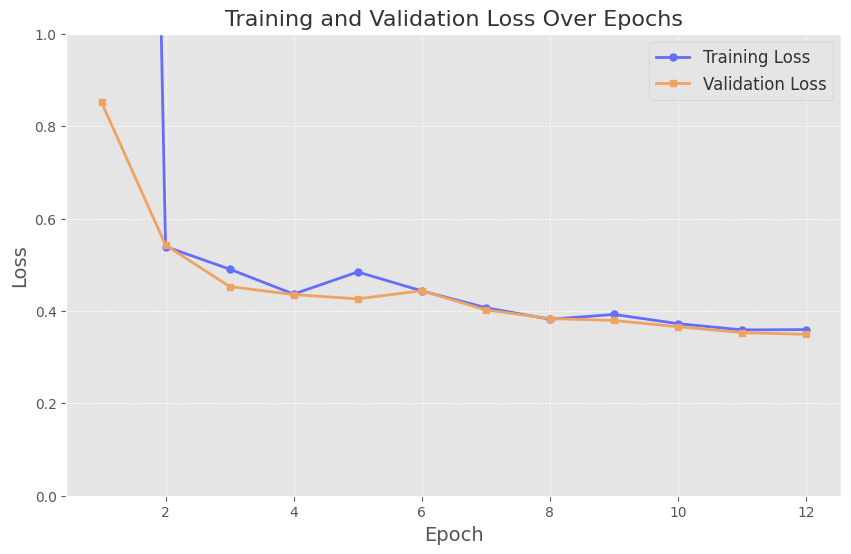

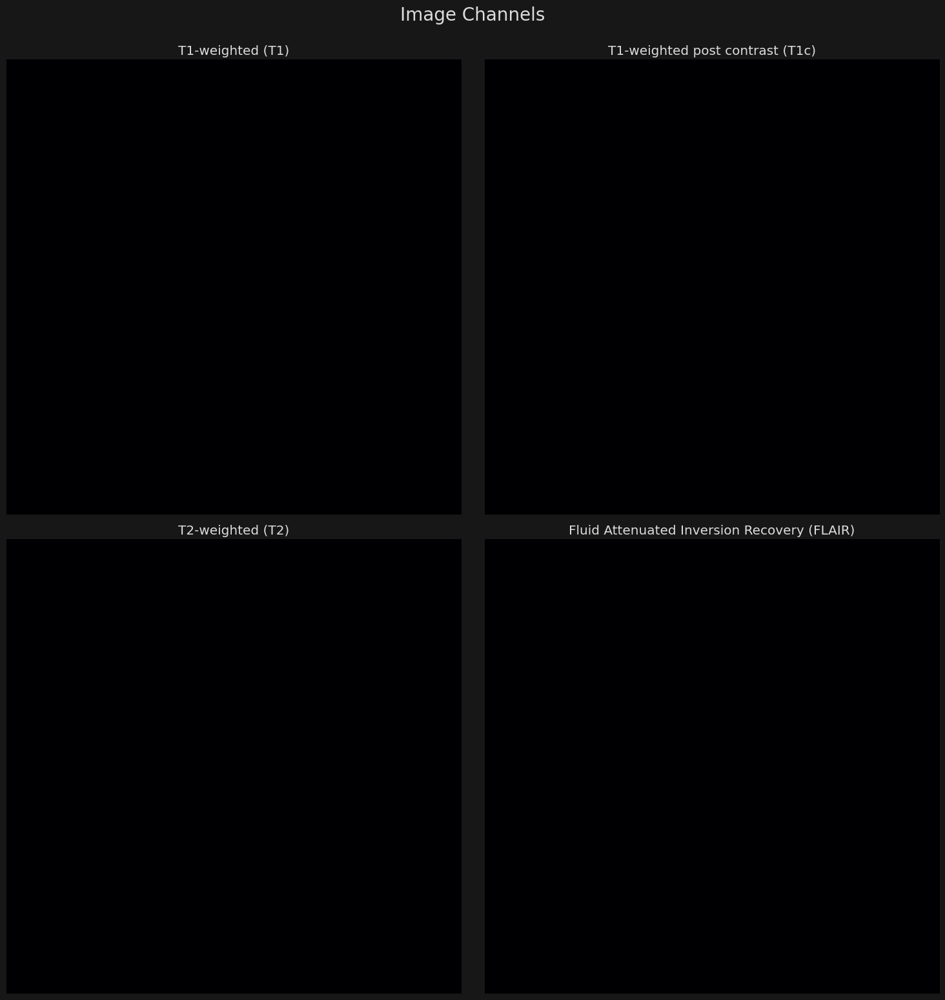

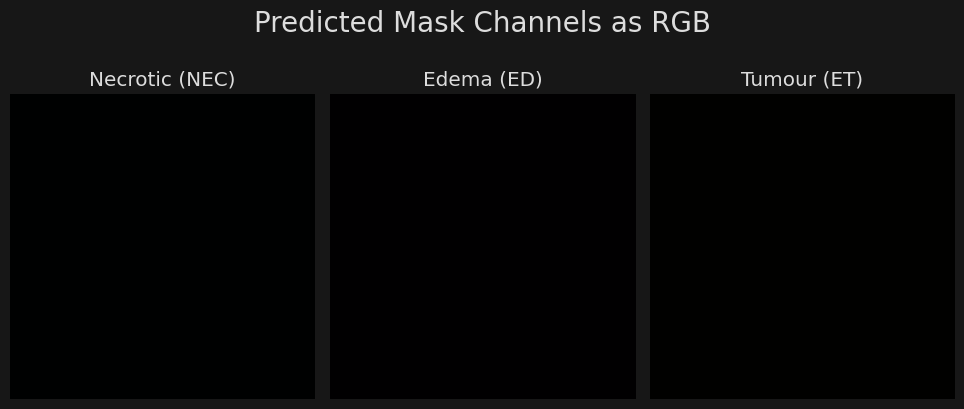

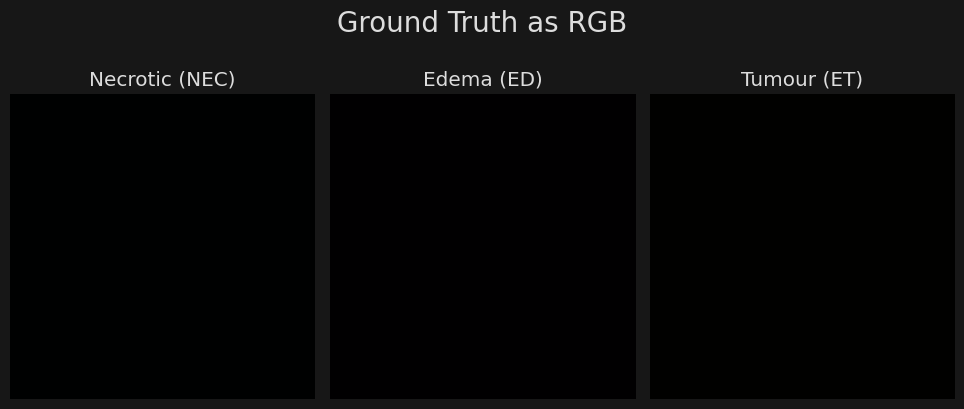

In [19]:
# Delete old model and clear GPU cache to release memory
del model
torch.cuda.empty_cache()

# Settings for training
train_config = {
    'device': 'cuda' if torch.cuda.is_available() else 'cpu',
    'n_epochs':          12,
    'batch_size':        32,
    'learning_rate':     1e-3,
    'batches_per_epoch': 50,
    'lr_decay_factor':   0.85
}

# Create UNet model and count params
model = UNet2()
count_parameters(model)

# Train model
train_epoch_losses, val_epoch_losses = train_model(model, train_dataloader, val_dataloader, train_config, verbose=False)

# Plot learning curves
plot_learning_curves(train_epoch_losses, val_epoch_losses)

# Performance on test image
display_test_sample(model, test_input, test_target, device)

#### Thoughts:
- We reduced the number of parameters in our model from ~5.5 million to ~3 million.
- Despite the reduced model size, our validation loss is less than the previous model's.
- Visualising our model's output, the improvement in performance is clear. The edges are sharper, and the model is beginning to distinguish between different parts of the tumour.

## Attention UNet
[Attention UNet](https://arxiv.org/abs/1804.03999) is a modified version of the UNet architecture that incorporates an attention mechanism into the basic UNet.

<img src="https://i.imgur.com/nI10XH4.png" 
     align="center" 
     width="700"
     style="padding: 20px;" />

Since the architecture presented in the original [Attention UNet](https://arxiv.org/abs/1804.03999) paper includes many of the dated UNet elements, we're going to build it into our modernised UNet.

The attention mechanism will be implemented over the skip connection, allowing our model to be able to allocate more resources to relevant regions, and 'tune out' the less important parts. The model will learn what to pay attention to during training.

<img src="https://i.imgur.com/bZrJrzT.png" 
     align="center" 
     width="700"
     style="padding: 20px;" />
     
To explain attention in the context of our image segmentation UNet:

The encoder has good spatial representation but worse feature representation. The decoder has strong feature representations, but may have lost spatial representations as the input moves deeper into the network.

The attention process begins with the *query* (marked with $g$ for *gate* in the diagram), which is derived from the decoder's feature maps. These feature maps are expected to contain a rich representation of the target structure due to the progressive decoding process.

The *key* is generated from the encoder's feature maps (marked $x$ in the diagram), which capture the input image's contextual information. The goal is to identify regions in the encoder's features that are relevant to the query from the decoder. 

The *query* and the *key* interact to produce the attention map. This map acts as a filter, highlighting areas to focus on. The attention mechanism computes this by aligning the query with the key, resulting in weights that signify the importance of each feature in the encoder's output.

The *value*, which is also derived from the encoder's feature maps, represents the content that we want to enhance or suppress. The attention map is applied to the *value* through element-wise multiplication, which scales the features accordingly. Features that are deemed relevant by the attention map are emphasized, while others are diminished.

This produces a weighted feature representation where the focus is directed toward the most informative parts of the input, thereby refining the information flow in the network and improving the quality of the segmentation output.

The attention mechanism effectively guides the model to pay more attention to specific areas of the feature maps, ensuring that the final output is more precise and relevant to the segmentation task.

### Building an Attention UNet Model
We'll build the attention mechanism into our custom-build UNet.

There are a few minor differences in how attention is implemented in our model, as we are adding the attended encoder features to the opposite decoder block's feature maps, rather than concatenating them. This approach should just perform better as well as reduce model parameters.

In [ ]:
class EncoderBlock(nn.Module):
    def __init__(self, in_channels, out_channels, activation=nn.ReLU()):
        super().__init__()
        expansion_ratio = 4
        
        self.encoder_block = nn.Sequential(
            nn.Conv2d(in_channels,                   in_channels, kernel_size=(7,7), stride=1, padding=3, groups=in_channels),
            nn.BatchNorm2d(in_channels),
            nn.Conv2d(in_channels,  expansion_ratio*out_channels, kernel_size=(1,1), stride=1),
            activation,
            nn.Conv2d(expansion_ratio*out_channels, out_channels, kernel_size=(1,1), stride=1),
            
            nn.Conv2d(out_channels,                 out_channels, kernel_size=(7,7), stride=1, padding=3, groups=out_channels),
            nn.BatchNorm2d(out_channels),
            nn.Conv2d(out_channels, expansion_ratio*out_channels, kernel_size=(1,1), stride=1),
            activation,
            nn.Conv2d(expansion_ratio*out_channels, out_channels, kernel_size=(1,1), stride=1),
        )
    def forward(self, x):
        return self.encoder_block(x)
    
class DecoderBlock(nn.Module):
    def __init__(self, in_channels, out_channels, activation=nn.ReLU()):
        super().__init__()
        expansion_ratio = 4
        
        self.decoder_block = nn.Sequential(
            nn.Conv2d(in_channels,                    in_channels, kernel_size=(7,7), stride=1, padding=3, groups=in_channels),
            nn.BatchNorm2d(in_channels),
            nn.Conv2d(in_channels,    expansion_ratio*in_channels, kernel_size=(1,1), stride=1),
            activation,
            nn.Conv2d(expansion_ratio*in_channels,   out_channels, kernel_size=(1,1), stride=1),
            
            nn.Conv2d(out_channels,                  out_channels, kernel_size=(7,7), stride=1, padding=3, groups=out_channels),
            nn.BatchNorm2d(out_channels),
            nn.Conv2d(out_channels,  expansion_ratio*out_channels, kernel_size=(1,1), stride=1),
            activation,
            nn.Conv2d(expansion_ratio*out_channels,  out_channels, kernel_size=(1,1), stride=1),
        )
    def forward(self, x):
        return self.decoder_block(x)
    
class AttentionResBlock(nn.Module):
    def __init__(self, in_channels, activation=nn.ReLU()):
        super().__init__()
        self.query_conv     = nn.Conv2d(in_channels, in_channels, kernel_size=(1,1), stride=1)
        self.key_conv       = nn.Conv2d(in_channels, in_channels, kernel_size=(1,1), stride=2)
        self.attention_conv = nn.Conv2d(in_channels, 1, kernel_size=(1,1), stride=1)
        
        self.upsample       = nn.UpsamplingBilinear2d(scale_factor=2)
        self.activation     = activation
    
    def forward(self, query, key, value):
        query = self.query_conv(query)
        key   = self.key_conv(key)
        
        combined_attention = self.activation(query + key)
        attention_map = torch.sigmoid(self.attention_conv(combined_attention))
        upsampled_attention_map = self.upsample(attention_map)
        attention_scores = value * upsampled_attention_map
        return attention_scores
        

class AttentionUNet(nn.Module):
    def __init__(self):
        super().__init__()
        
        # Config
        in_channels  = 4   # Input images have 4 channels
        out_channels = 3   # Mask has 3 channels
        n_filters    = 32  # Scaled down from 64 in original paper
        activation   = nn.ReLU()
        
        # Up and downsampling methods
        self.downsample  = nn.MaxPool2d((2,2), stride=2)
        self.upsample    = nn.UpsamplingBilinear2d(scale_factor=2)
        
        # Encoder
        self.enc_block_1 = EncoderBlock(in_channels, 1*n_filters, activation)
        self.enc_block_2 = EncoderBlock(1*n_filters, 2*n_filters, activation)
        self.enc_block_3 = EncoderBlock(2*n_filters, 4*n_filters, activation)
        self.enc_block_4 = EncoderBlock(4*n_filters, 8*n_filters, activation)
        
        # Bottleneck
        self.bottleneck = nn.Sequential(
            nn.Conv2d(     8*n_filters,   8*n_filters, kernel_size=(7,7), stride=1, padding=3, groups=8*n_filters),
            nn.BatchNorm2d(8*n_filters),
            nn.Conv2d(     8*n_filters, 4*8*n_filters, kernel_size=(1,1), stride=1),
            activation,
            nn.Conv2d(   4*8*n_filters,   8*n_filters, kernel_size=(1,1), stride=1),

            nn.Conv2d(     8*n_filters,   8*n_filters, kernel_size=(7,7), stride=1, padding=3, groups=8*n_filters),
            nn.BatchNorm2d(8*n_filters),
            nn.Conv2d(     8*n_filters, 4*8*n_filters, kernel_size=(1,1), stride=1),
            activation,
            nn.Conv2d(   4*8*n_filters,   8*n_filters, kernel_size=(1,1), stride=1),
        )
        
        # Decoder
        self.dec_block_4 = DecoderBlock(8*n_filters, 4*n_filters, activation)
        self.dec_block_3 = DecoderBlock(4*n_filters, 2*n_filters, activation)
        self.dec_block_2 = DecoderBlock(2*n_filters, 1*n_filters, activation)
        self.dec_block_1 = DecoderBlock(1*n_filters, 1*n_filters, activation)
        
        # Output projection
        self.output      = nn.Conv2d(1*n_filters,  out_channels, kernel_size=(1,1), stride=1, padding=0)
        
        # Attention res blocks
        self.att_res_block_1 = AttentionResBlock(1*n_filters)
        self.att_res_block_2 = AttentionResBlock(2*n_filters)
        self.att_res_block_3 = AttentionResBlock(4*n_filters)
        self.att_res_block_4 = AttentionResBlock(8*n_filters)

    def forward(self, x):
        # Encoder
        enc_1 = self.enc_block_1(x)
        x     = self.downsample(enc_1)
        enc_2 = self.enc_block_2(x)
        x     = self.downsample(enc_2)
        enc_3 = self.enc_block_3(x)
        x     = self.downsample(enc_3)
        enc_4 = self.enc_block_4(x)
        x     = self.downsample(enc_4)
        
        # Bottleneck
        dec_4 = self.bottleneck(x)
        
        # Decoder
        x     = self.upsample(dec_4)
        att_4 = self.att_res_block_4(dec_4, enc_4, enc_4)  # QKV
        x     = torch.add(x, att_4)  # Add attention masked value rather than concat
        
        dec_3 = self.dec_block_4(x)
        x     = self.upsample(dec_3)
        att_3 = self.att_res_block_3(dec_3, enc_3, enc_3)
        x     = torch.add(x, att_3)  # Add attention
        
        dec_2 = self.dec_block_3(x)
        x     = self.upsample(dec_2)
        att_2 = self.att_res_block_2(dec_2, enc_2, enc_2)
        x     = torch.add(x, att_2)  # Add attention
        
        dec_1 = self.dec_block_2(x)
        x     = self.upsample(dec_1)
        att_1 = self.att_res_block_1(dec_1, enc_1, enc_1)
        x     = torch.add(x, att_1)  # Add attention
        
        x     = self.dec_block_1(x)
        x     = self.output(x)
        return x

### Training Loop
In this training loop we increase the number of epochs to 25 and slightly increase the learning rate decay constant to accommodate for this greater number of epochs.

In [ ]:
# Delete old model and clear GPU cache to release memory
del model
torch.cuda.empty_cache()

# Settings for training
train_config = {
    'device': 'cuda' if torch.cuda.is_available() else 'cpu',
    'n_epochs':          25,
    'batch_size':        32,
    'learning_rate':     1e-3,
    'batches_per_epoch': 50,
    'lr_decay_factor':   0.93
}

# Create UNet model and count params
model = AttentionUNet()
count_parameters(model)

# Train model
train_epoch_losses, val_epoch_losses = train_model(model, train_dataloader, val_dataloader, train_config, verbose=False)

# Save weights
save_model(model, 'attention-unet-weights.pth')

# Plot learning curves
plot_learning_curves(train_epoch_losses, val_epoch_losses)

# Performance on test image
display_test_sample(model, test_input, test_target, device)

#### Thoughts:
- This model has approximately the same number of parameters as before ~3 million.
- With the extra epochs, we have brought our validation loss down to half the orignal models. 
- The model's output is very impressive. The different regions are clearly separated and the model has achieved state of the art performance.

## Visualising Attention
We can easily visualise attention by modifying our code to return the attention mask during the forward pass, so we can plot it.

In [ ]:
class AttentionResBlock(nn.Module):
    def __init__(self, in_channels, activation=nn.ReLU()):
        super().__init__()
        self.query_conv     = nn.Conv2d(in_channels, in_channels, kernel_size=(1,1), stride=1)
        self.key_conv       = nn.Conv2d(in_channels, in_channels, kernel_size=(1,1), stride=2)
        self.attention_conv = nn.Conv2d(in_channels, 1, kernel_size=(1,1), stride=1)
        
        self.upsample       = nn.UpsamplingBilinear2d(scale_factor=2)
        self.activation     = activation
    
    def forward(self, query, key, value):
        query = self.query_conv(query)
        key   = self.key_conv(key)
        
        combined_attention = self.activation(query + key)
        attention_map = torch.sigmoid(self.attention_conv(combined_attention))
        upsampled_attention_map = self.upsample(attention_map)
        attention_scores = value * upsampled_attention_map
        return attention_scores, attention_map  # Additionally return attention map
        

class AttentionVisUNet(nn.Module):
    def __init__(self):
        super().__init__()
        
        # Config
        in_channels  = 4   # Input images have 4 channels
        out_channels = 3   # Mask has 3 channels
        n_filters    = 32  # Scaled down from 64 in original paper
        activation   = nn.ReLU()
        
        # Up and downsampling methods
        self.downsample  = nn.MaxPool2d((2,2), stride=2)
        self.upsample    = nn.UpsamplingBilinear2d(scale_factor=2)
        
        # Encoder
        self.enc_block_1 = EncoderBlock(in_channels, 1*n_filters, activation)
        self.enc_block_2 = EncoderBlock(1*n_filters, 2*n_filters, activation)
        self.enc_block_3 = EncoderBlock(2*n_filters, 4*n_filters, activation)
        self.enc_block_4 = EncoderBlock(4*n_filters, 8*n_filters, activation)
        
        # Bottleneck
        self.bottleneck = nn.Sequential(
            nn.Conv2d(     8*n_filters,   8*n_filters, kernel_size=(7,7), stride=1, padding=3, groups=8*n_filters),
            nn.BatchNorm2d(8*n_filters),
            nn.Conv2d(     8*n_filters, 4*8*n_filters, kernel_size=(1,1), stride=1),
            activation,
            nn.Conv2d(   4*8*n_filters,   8*n_filters, kernel_size=(1,1), stride=1),

            nn.Conv2d(     8*n_filters,   8*n_filters, kernel_size=(7,7), stride=1, padding=3, groups=8*n_filters),
            nn.BatchNorm2d(8*n_filters),
            nn.Conv2d(     8*n_filters, 4*8*n_filters, kernel_size=(1,1), stride=1),
            activation,
            nn.Conv2d(   4*8*n_filters,   8*n_filters, kernel_size=(1,1), stride=1),
        )
        
        # Decoder
        self.dec_block_4 = DecoderBlock(8*n_filters, 4*n_filters, activation)
        self.dec_block_3 = DecoderBlock(4*n_filters, 2*n_filters, activation)
        self.dec_block_2 = DecoderBlock(2*n_filters, 1*n_filters, activation)
        self.dec_block_1 = DecoderBlock(1*n_filters, 1*n_filters, activation)
        
        # Output projection
        self.output      = nn.Conv2d(1*n_filters,  out_channels, kernel_size=(1,1), stride=1, padding=0)
        
        # Attention res blocks
        self.att_res_block_1 = AttentionResBlock(1*n_filters)
        self.att_res_block_2 = AttentionResBlock(2*n_filters)
        self.att_res_block_3 = AttentionResBlock(4*n_filters)
        self.att_res_block_4 = AttentionResBlock(8*n_filters)

    def forward(self, x):
        # Encoder
        enc_1 = self.enc_block_1(x)
        x     = self.downsample(enc_1)
        enc_2 = self.enc_block_2(x)
        x     = self.downsample(enc_2)
        enc_3 = self.enc_block_3(x)
        x     = self.downsample(enc_3)
        enc_4 = self.enc_block_4(x)
        x     = self.downsample(enc_4)
        
        # Bottleneck
        dec_4 = self.bottleneck(x)
        
        # Decoder
        x     = self.upsample(dec_4)
        att_4, map_4 = self.att_res_block_4(dec_4, enc_4, enc_4)  # Get attention maps
        x     = torch.add(x, att_4)  # Add attention masked value rather than concat
        
        dec_3 = self.dec_block_4(x)
        x     = self.upsample(dec_3)
        att_3, map_3 = self.att_res_block_3(dec_3, enc_3, enc_3)
        x     = torch.add(x, att_3)  # Add attention
        
        dec_2 = self.dec_block_3(x)
        x     = self.upsample(dec_2)
        att_2, map_2 = self.att_res_block_2(dec_2, enc_2, enc_2)
        x     = torch.add(x, att_2)  # Add attention
        
        dec_1 = self.dec_block_2(x)
        x     = self.upsample(dec_1)
        att_1, map_1 = self.att_res_block_1(dec_1, enc_1, enc_1)
        x     = torch.add(x, att_1)  # Add attention
        
        x     = self.dec_block_1(x)
        x     = self.output(x)
        return x, map_4, map_3, map_2, map_1  # Return attention maps for plotting
    
# Build attention visualisation model, load to device then load trained weights
att_vis_unet = AttentionVisUNet().to(device)
att_vis_unet.load_state_dict(torch.load('attention-unet-weights.pth'))

# Forward pass to get attention maps
_, map_4, map_3, map_2, map_1 = att_vis_unet(test_input.to(device))

# Plot atttention maps
fig, axes = plt.subplots(2, 2, figsize=(10, 10))
for idx, (ax, att_map) in enumerate(zip(axes.flatten(), [map_4, map_3, map_2, map_1])):
    power = 2**(3 - idx)
    ax.imshow(att_map.detach().cpu().numpy().reshape(120//power,120//power), cmap='magma')
    ax.set_title(f'Attention Map {4-idx}')
    ax.grid(False)

#### Thoughts:
- The 4th attention map interestingly pays no attention to the brain itself, only the area surrounding it. This indicates that this residual pathway may not be very helpful.
- The 3rd map bas found the region the tumour is in, and looks like it's trying to ignore the healthy parts of the brain more than anything.
- Maps 1 and 2 both highlight the tumour more clearly, but also attends to areas of the background.